In [2]:
from datetime import datetime

import statsmodels.api as sm
import dateparser as dateparser
import matplotlib
import matplotlib.pylab as pylab
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import scipy.stats as stats
import pylab as py
import statsmodels.stats.api as sms

In [3]:
measurements_file = "data/measurements.csv"
measurements_data = pd.read_csv(measurements_file, sep='\t')
measurements_data.info()
measurements_data.head(20)

#'h1 h0'

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12068 entries, 0 to 12067
Data columns (total 18 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   PM10       12019 non-null  float64
 1   CO         12019 non-null  float64
 2   Pb         12019 non-null  float64
 3   C2H3NO5    12019 non-null  float64
 4   CFCs       12019 non-null  float64
 5   H2CO       12018 non-null  float64
 6   O3         12020 non-null  float64
 7   TEMP       12020 non-null  float64
 8   NOx        12018 non-null  float64
 9   SO2        12020 non-null  float64
 10  latitude   12068 non-null  float64
 11  longitude  12068 non-null  float64
 12  NH3        12018 non-null  float64
 13  CH4        12018 non-null  float64
 14  PRES       12068 non-null  float64
 15  PM2.5      12020 non-null  float64
 16  warning    12018 non-null  float64
 17  PAHs       12020 non-null  float64
dtypes: float64(18)
memory usage: 1.7 MB


,PM10,CO,Pb,C2H3NO5,CFCs,H2CO,O3,TEMP,NOx,SO2,latitude,longitude,NH3,CH4,PRES,PM2.5,warning,PAHs
0,6.33846,6.61796,44.89247,0.22646,37.51693,39.50358,6.93304,18.26344,7.24953,8.60015,53.95278,32.86389,5.35805,6.00130,1136.95323,10.59506,1.0,9.24391
1,7.90785,8.15426,50.02976,0.40716,49.00037,41.15652,10.00080,18.84880,7.08920,8.16071,9.33370,122.86370,6.22960,7.40706,1104.78569,7.82884,0.0,NaN
2,6.78253,7.32578,50.42226,0.27588,53.51533,61.03352,6.41183,13.61953,8.25103,8.93315,58.63667,59.80222,5.16975,5.07507,1148.76311,10.04912,1.0,8.73640
3,5.71508,9.26158,26.86094,0.18788,35.69230,57.17648,7.94233,16.76223,4.10062,4.44370,12.95629,78.27539,5.76106,7.01203,1089.36057,10.53430,1.0,8.67231
4,9.16375,7.12481,48.82457,1.32986,32.22006,46.82387,11.63958,12.48813,6.26932,7.81736,32.54044,-82.90375,5.96896,8.44913,1099.39295,9.40919,0.0,4.80834
5,7.04390,7.96828,56.56011,0.31311,56.18221,41.18541,10.42120,12.74538,8.75889,7.43447,37.73604,-120.93549,8.58263,6.89506,1050.67737,7.20484,0.0,6.00215
6,8.07997,6.40977,58.46766,0.67969,60.60543,34.99728,9.14442,22.17319,6.75870,8.48118,3.51667,11.50000,7.64965,8.33486,1107.84036,8.70999,0.0,6.88903
7,7.29130,7.98165,51.66434,0.32651,58.74764,34.19093,8.08972,2.44131,8.52918,7.19837,34.09668,-117.71978,9.57044,9.39463,1151.83879,6.68114,1.0,6.25543
8,8.35517,6.93280,19.34860,0.81349,55.69528,41.58524,9.23259,2.99513,7.51361,5.92541,10.20898,123.75800,5.64815,8.15221,1121.79391,8.18714,0.0,4.12422
9,8.13981,7.40637,61.53701,0.61849,47.76755,61.36477,10.36692,13.31374,7.97743,7.96606,4.02219,101.02083,9.85029,7.40917,1157.28796,8.65797,1.0,7.83400


In [4]:
stations_file = "data/stations.csv"
stations_data = pd.read_csv(stations_file, sep='\t')
stations_data.info()
stations_data

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1110 entries, 0 to 1109
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   QoS        1110 non-null   object 
 1   station    1110 non-null   object 
 2   code       1109 non-null   object 
 3   latitude   1110 non-null   float64
 4   longitude  1110 non-null   float64
 5   revision   1110 non-null   object 
dtypes: float64(2), object(4)
memory usage: 52.2+ KB


,QoS,station,code,latitude,longitude,revision
0,good,Casa Blanca,MX,19.04222,-98.11889,2019-11-27
1,building,Mikhaylovka,RU,50.06000,43.23790,"07/26/2017, 00:00:00"
2,building,Shahre Jadide Andisheh,IR,35.68030,51.01930,01 Jun 2013
3,building,Aracaju,BR,-10.91111,-37.07167,2012/12/29
4,maintenance,Parola,IN,20.88098,75.11937,2019/07/05
...,...,...,...,...,...,...
1105,building,Tadmur,SY,34.56240,38.28402,2013/07/10
1106,average,Jizzax,UZ,40.11583,67.84222,30 May 2013
1107,accep,West Chester,US,39.96097,-75.60804,"11/04/2012, 00:00:00"
1108,accep,Oktyabr‚Äôskiy,RU,54.48147,53.47103,18 Apr 2015


In [5]:
stations_data['date'] = stations_data.apply(lambda row: dateparser.parse(row.revision, settings={'TIMEZONE': 'CEST'}), axis = 1)

In [6]:
df=pd.merge(stations_data, measurements_data, on=['latitude', 'longitude'], how='right')
# df['warning'] = df['warning'].astype(bool)
df.head(20)
# df.to_csv('out.csv')
df.drop_duplicates(subset=['code'])
# 'QoS','station','code','latitude','longitude', 'revision', 'date', 'PM10', 'CO', 'Pb', 'C2H3NO5', 'CFCs', 'H2CO', 'O3', 'TEMP', 'NOx', 'SO2', 'NH3', 'CH4', 'PRES', 'PM2.5', 'warning', 'PAHs'
df.head(20)
# df.info()

,QoS,station,code,latitude,longitude,revision,date,PM10,CO,Pb,...,O3,TEMP,NOx,SO2,NH3,CH4,PRES,PM2.5,warning,PAHs
0,maintenance,Roslavl‚Äô,RU,53.95278,32.86389,"09/12/2017, 00:00:00",2017-09-12,6.33846,6.61796,44.89247,...,6.93304,18.26344,7.24953,8.60015,5.35805,6.00130,1136.95323,10.59506,1.0,9.24391
1,average,Roslavl‚Äô,RU,53.95278,32.86389,2015-09-03,2015-09-03,6.33846,6.61796,44.89247,...,6.93304,18.26344,7.24953,8.60015,5.35805,6.00130,1136.95323,10.59506,1.0,9.24391
2,good,Santa Catalina,PH,9.33370,122.86370,"12/17/2015, 00:00:00",2015-12-17,7.90785,8.15426,50.02976,...,10.00080,18.84880,7.08920,8.16071,6.22960,7.40706,1104.78569,7.82884,0.0,NaN
3,accep,Santa Catalina,PH,9.33370,122.86370,"11/29/2020, 00:00:00",2020-11-29,7.90785,8.15426,50.02976,...,10.00080,18.84880,7.08920,8.16071,6.22960,7.40706,1104.78569,7.82884,0.0,NaN
4,building,Santa Catalina,PH,9.33370,122.86370,13 May 2018,2018-05-13,7.90785,8.15426,50.02976,...,10.00080,18.84880,7.08920,8.16071,6.22960,7.40706,1104.78569,7.82884,0.0,NaN
5,accep,Lesnoy,RU,58.63667,59.80222,2015/10/13,2015-10-13,6.78253,7.32578,50.42226,...,6.41183,13.61953,8.25103,8.93315,5.16975,5.07507,1148.76311,10.04912,1.0,8.73640
6,maintenance,Robertsonpet,IN,12.95629,78.27539,"10/24/2013, 00:00:00",2013-10-24,5.71508,9.26158,26.86094,...,7.94233,16.76223,4.10062,4.44370,5.76106,7.01203,1089.36057,10.53430,1.0,8.67231
7,good,Dublin,US,32.54044,-82.90375,2021-05-13,2021-05-13,9.16375,7.12481,48.82457,...,11.63958,12.48813,6.26932,7.81736,5.96896,8.44913,1099.39295,9.40919,0.0,4.80834
8,excellent,Dublin,US,32.54044,-82.90375,2017-11-11,2017-11-11,9.16375,7.12481,48.82457,...,11.63958,12.48813,6.26932,7.81736,5.96896,8.44913,1099.39295,9.40919,0.0,4.80834
9,acceptable,Riverbank,US,37.73604,-120.93549,"02/25/2021, 00:00:00",2021-02-25,7.04390,7.96828,56.56011,...,10.42120,12.74538,8.75889,7.43447,8.58263,6.89506,1050.67737,7.20484,0.0,6.00215


In [6]:
print(
df['QoS'].unique(), '\n',
df['station'].unique(),'\n',
df['code'].unique(),'\n',
df['date'].unique()
)

# df[df['QoS'] == 'maitennce']

['good' 'average' 'building' 'maintenance' 'excellent' 'accep'
 'acceptable' 'maitennce'] 
 ['Casa Blanca' 'Mikhaylovka' 'Shahre Jadide Andisheh' 'Aracaju' 'Parola'
 'Kheda' 'Caldas Novas' 'Freetown' 'Frankston South' 'Gorakhpur'
 'Robertsonpet' 'Houthalen' 'Riverbank' 'Nonoichi' 'Barmbek-Nord'
 'Burscheid' 'Dumont' 'Tsuen Wan' 'San Juan' 'Arbroath' 'Kushtia'
 'Ajdabiya' 'Zaozhuang' 'Honda' 'Brierley Hill' 'Odessa' 'Lino Lakes'
 'Kyzylorda' 'Crystal Lake' 'Milledgeville' 'Valletta' 'Cardedeu' 'Oulmes'
 'Tupiza' 'Arzamas' 'Zeitz' 'Sun City Center' 'Schwalmtal' 'Sakaraha'
 'Cibinong' 'Madhipura' 'Ken Caryl' 'Norwalk' 'Resplendor' 'Selby'
 'Thap Than' 'Lutz' 'Damnoen Saduak' 'Beni' 'Shaowu' 'Kallio'
 "'Ali Sabieh" 'Dax' 'Hrazdan' 'Ferrol' 'Gonesse' 'Carlsbad' 'Bothell'
 'Kingston upon Hull' 'Keizer' 'Oktyabr‚Äôskiy' 'Mampong' 'Carindale'
 'Puerto Colombia' 'Magong' 'T‚Äôaebaek' 'Bensheim' 'Tavda' 'Sassari'
 'Buynaksk' 'Aberdeen' 'Wangon' 'Saint-Genis-Laval' 'Marburg an der Lahn'
 'Chillum

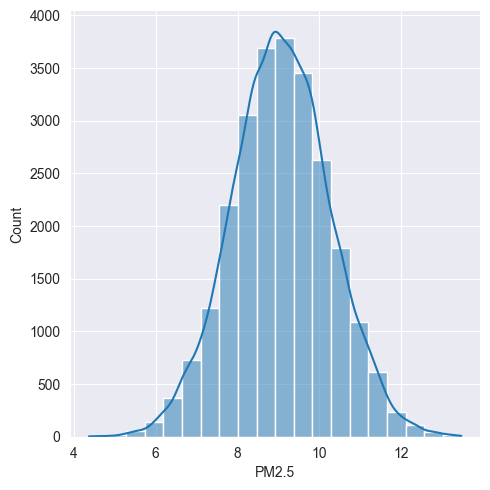

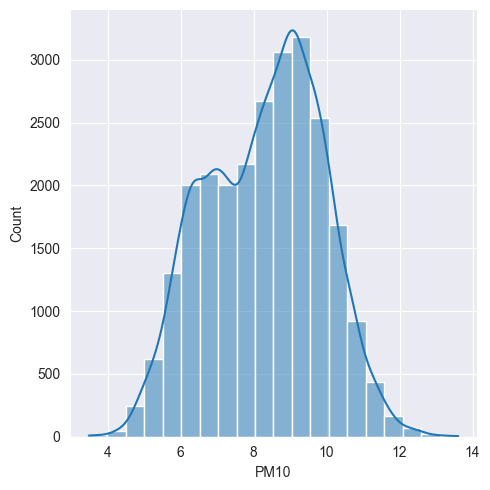

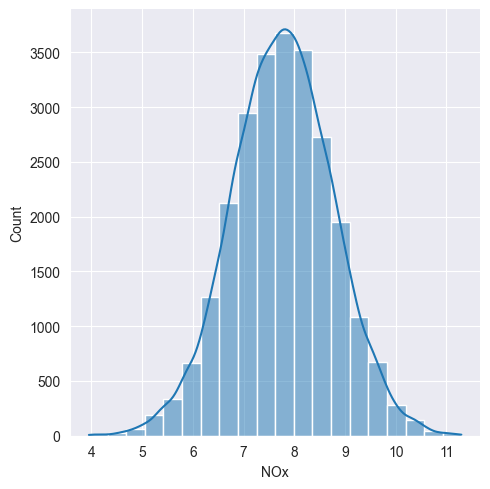

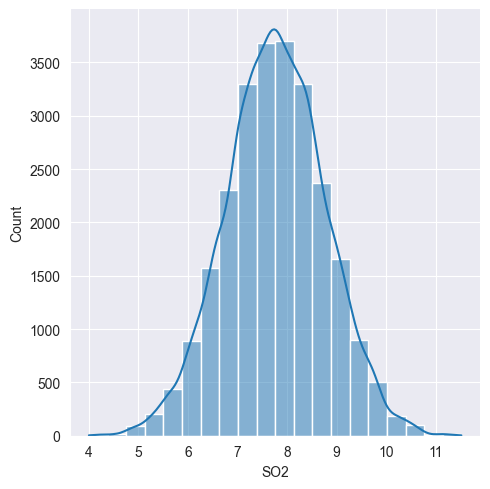

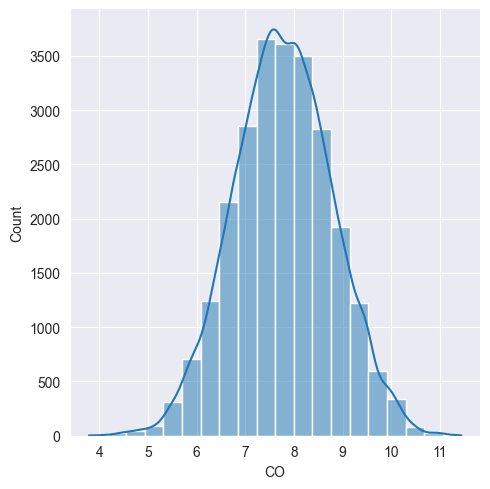

...

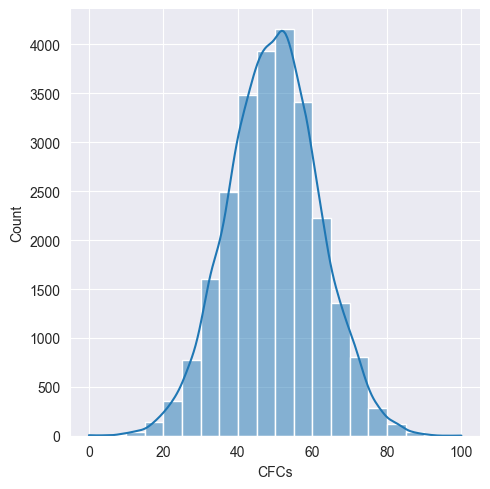

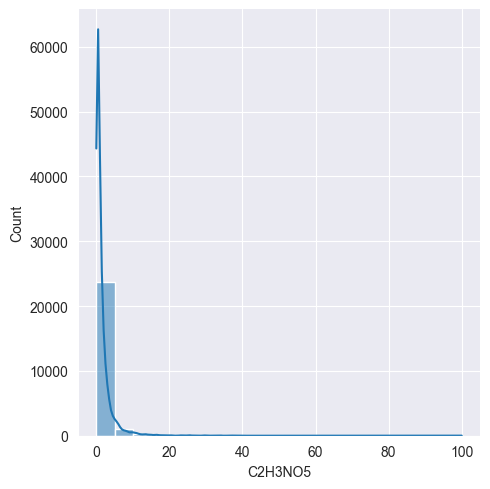

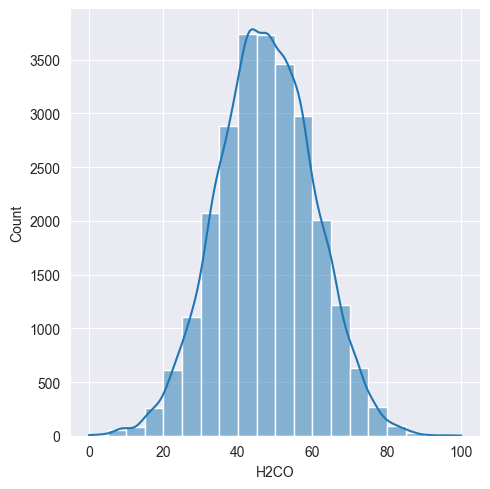

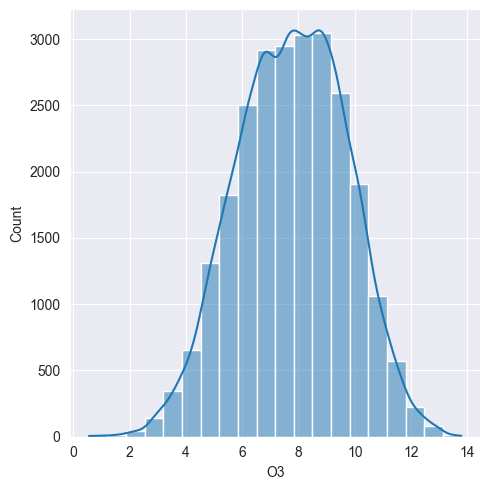

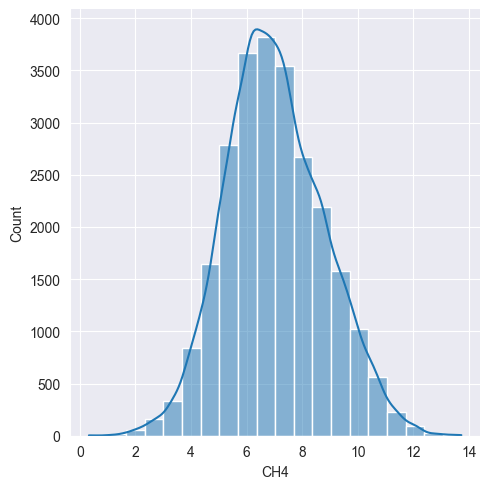

In [7]:
sns.displot(df['PM2.5'], bins=20, kde=True)
sns.displot(df['PM10'], bins=20, kde=True)
sns.displot(df['NOx'], bins=20, kde=True)
sns.displot(df['SO2'], bins=20, kde=True)
sns.displot(df['CO'], bins=20, kde=True)
sns.displot(df['PAHs'], bins=20, kde=True)
sns.displot(df['NH3'], bins=20, kde=True)
sns.displot(df['Pb'], bins=20, kde=True)
sns.displot(df['TEMP'], bins=20, kde=True)
sns.displot(df['PRES'], bins=20, kde=True)
sns.displot(df['CFCs'], bins=20, kde=True)
sns.displot(df['C2H3NO5'], bins=20, kde=True)
sns.displot(df['H2CO'], bins=20, kde=True)
sns.displot(df['O3'], bins=20, kde=True)
sns.displot(df['CH4'], bins=20, kde=True)

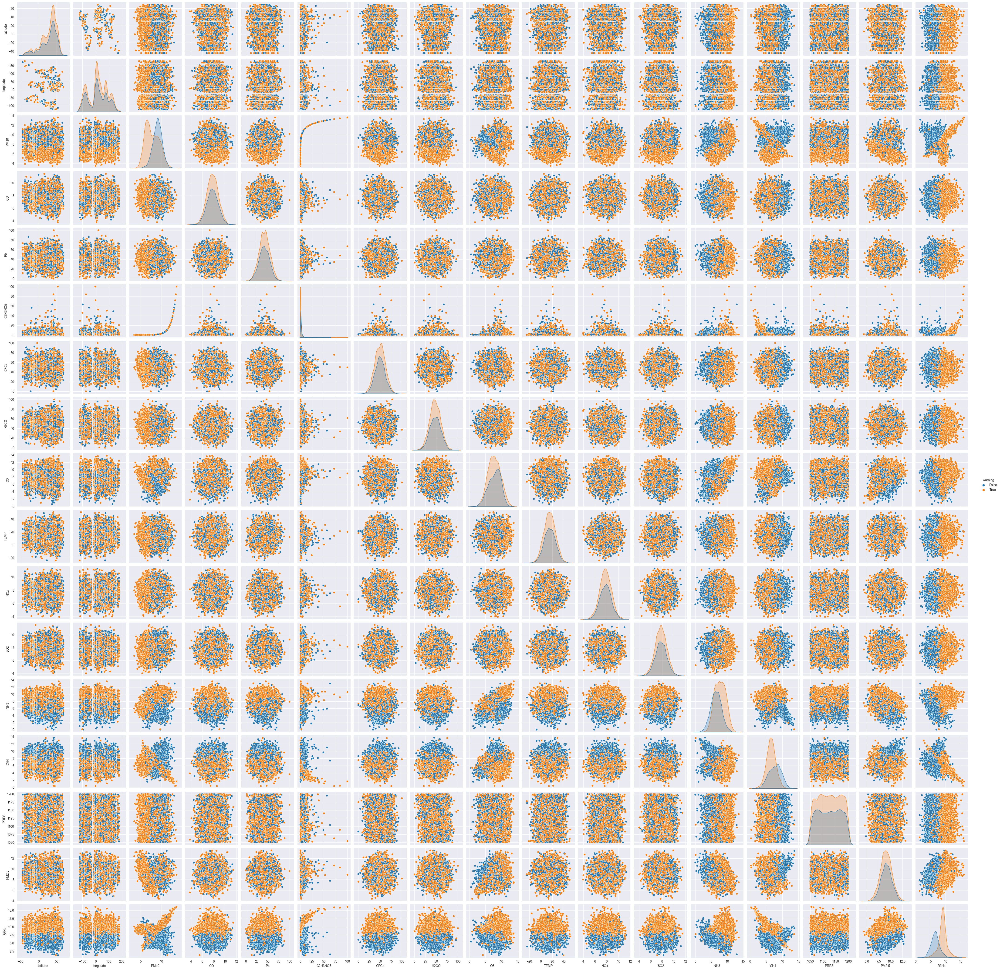

In [11]:
sns.pairplot(df, hue="warning")

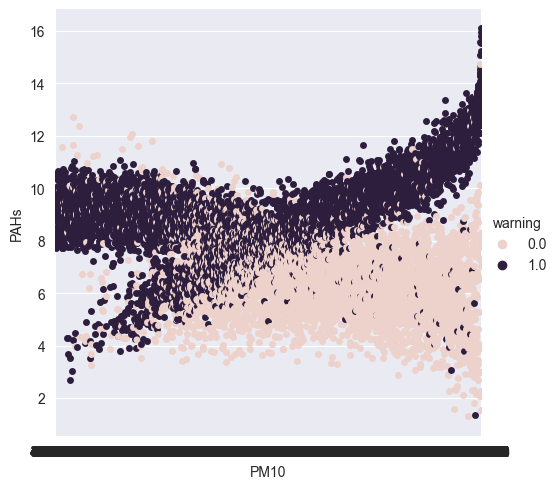

In [7]:
sns.catplot(x="PM10", y='PAHs', hue="warning", data=measurements_data)

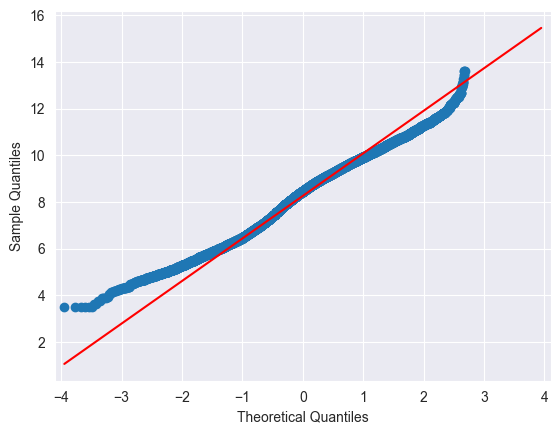

In [21]:
sm.qqplot(df['PM10'], line='q')
py.show()

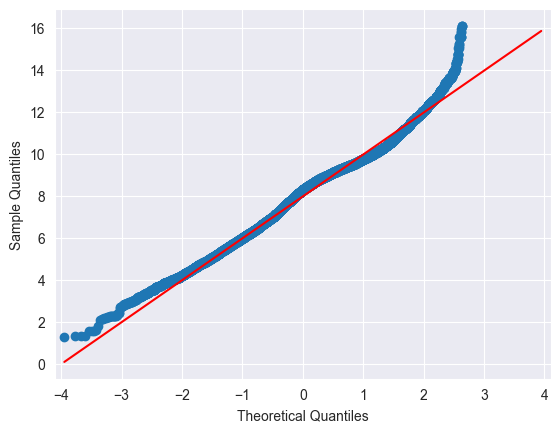

In [22]:
sm.qqplot(df['PAHs'], line='q')
py.show()

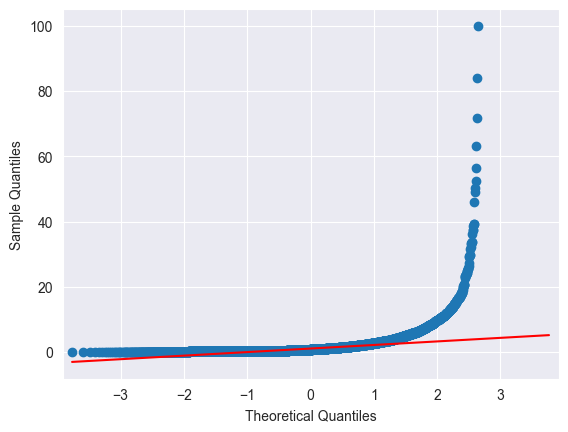

In [75]:
sm.qqplot(measurements_data['C2H3NO5'], line='q')
py.show()

/Users/davidpenta/Documents/FIIT/IAU/iau_env/lib/python3.9/site-packages/seaborn/algorithms.py:98: RuntimeWarning: Mean of empty slice
  boot_dist.append(f(*sample, **func_kwargs))
/Users/davidpenta/Documents/FIIT/IAU/iau_env/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1559: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a,
/Users/davidpenta/Documents/FIIT/IAU/iau_env/lib/python3.9/site-packages/seaborn/algorithms.py:98: RuntimeWarning: Mean of empty slice
  boot_dist.append(f(*sample, **func_kwargs))
/Users/davidpenta/Documents/FIIT/IAU/iau_env/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1559: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a,
/Users/davidpenta/Documents/FIIT/IAU/iau_env/lib/python3.9/site-packages/seaborn/algorithms.py:98: RuntimeWarning: Mean of empty slice
  boot_dist.append(f(*sample, **func_kwargs))
/Users/davidpenta/Documents/FIIT/IAU/iau_env/lib/python3.9/site-packages/numpy/lib/nanfunctio

<AxesSubplot: xlabel='PAHs', ylabel='PM10'>

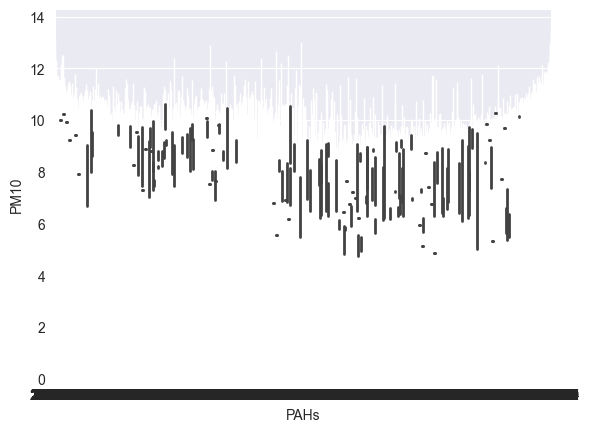

In [25]:
sns.barplot(x='PAHs', y='PM10', data=df[(df.warning == True) | (df.warning == False)],
            capsize=0.1, errwidth=2, palette=sns.color_palette("Blues"))

In [78]:
def identify_outliers(a):
    lower = a.quantile(0.25) - 1.5 * stats.iqr(a)
    upper = a.quantile(0.75) + 1.5 * stats.iqr(a)

    return a[(a > upper) | (a < lower)]
C2H3NO5_out = identify_outliers(df['C2H3NO5'].dropna())

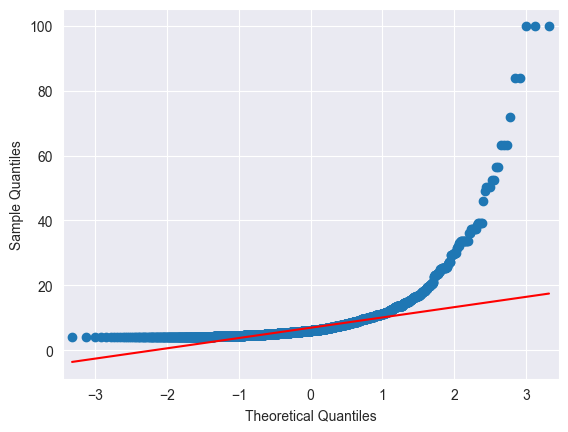

In [76]:
sm.qqplot(C2H3NO5_out, line='q')
py.show()

In [80]:
sms.DescrStatsW(C2H3NO5_out).tconfint_mean()

(8.096275309094924, 8.728240069355664)